In [ ]:
!pip install roboflow

In [ ]:
# !pip install ultralytics
!pip install ultralytics==8.0.196

In [ ]:
from roboflow import Roboflow

In [ ]:
import os

# Create main directory for the combined dataset
combined_dataset_dir = 'combined_dataset'
os.makedirs(combined_dataset_dir, exist_ok=True)

# Create subdirectories for train, valid, and test sets
subdirs = ['train', 'valid', 'test']
for subdir in subdirs:
    os.makedirs(os.path.join(combined_dataset_dir, subdir), exist_ok=True)


In [ ]:
import os
import shutil

# Function to map all classes to class 0
def map_classes_to_zero(label_file):
    with open(label_file, 'r') as file:
        lines = file.readlines()

    with open(label_file, 'w') as file:
        for line in lines:
            class_id, *rest = line.strip().split()
            new_class_id = 0  # Map any class ID to 0
            file.write(f"{new_class_id} " + " ".join(rest) + "\n")

# Function to combine the datasets and map all class IDs to 0
def combine_datasets(src_dirs, dest_dir):
    for phase in ['train', 'valid', 'test']:
        for folder in ['images', 'labels']:
            dest_folder = os.path.join(dest_dir, phase, folder)
            if not os.path.exists(dest_folder):
                os.makedirs(dest_folder)

            for src_dir in src_dirs:
                src_folder = os.path.join(src_dir, phase, folder)
                if not os.path.exists(src_folder):
                    continue  # Skip if the folder does not exist
                for file_name in os.listdir(src_folder):
                    src_file = os.path.join(src_folder, file_name)
                    dest_file = os.path.join(dest_folder, file_name)
                    shutil.copy(src_file, dest_file)
                    if folder == 'labels':
                        map_classes_to_zero(dest_file)

# List of source directories for the three datasets
src_dirs = [dataset1.location, dataset2.location, dataset3.location]

# Combine the datasets into "combined_dataset", mapping all classes to 0
combine_datasets(src_dirs, "combined_dataset")


In [ ]:
yaml_content = """
train: combined_dataset/train/images
val: combined_dataset/valid/images
test: combined_dataset/test/images

nc: 1  # Number of classes
names: [emergency_car]
"""

# Write the yaml file
with open("data.yaml", "w") as file:
    file.write(yaml_content)


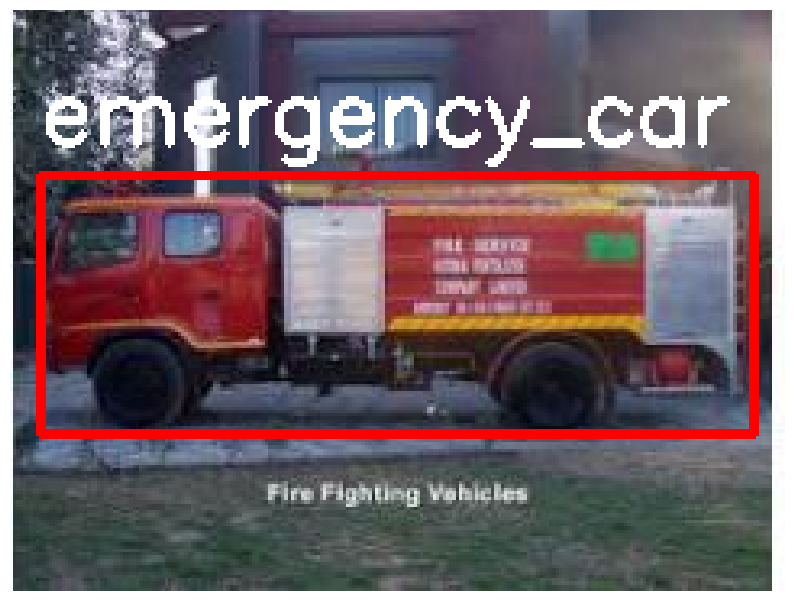

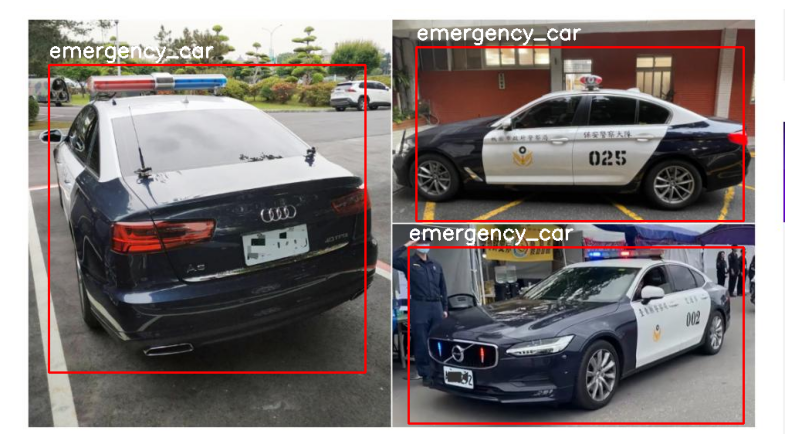

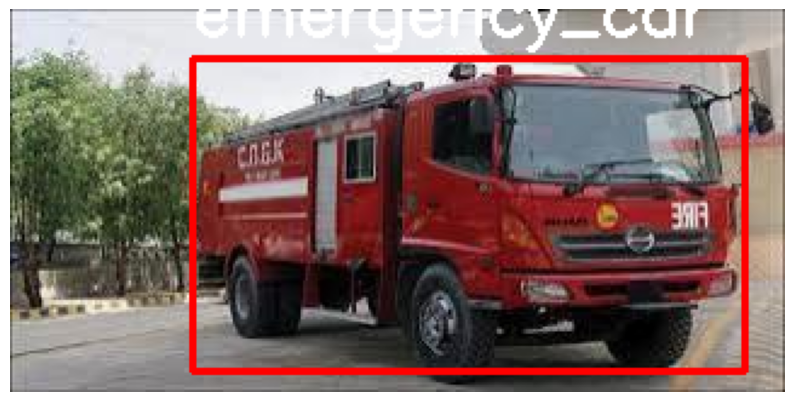

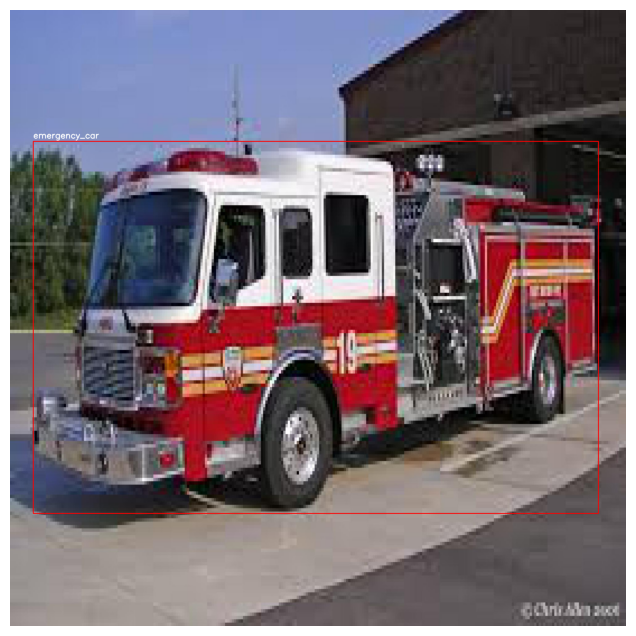

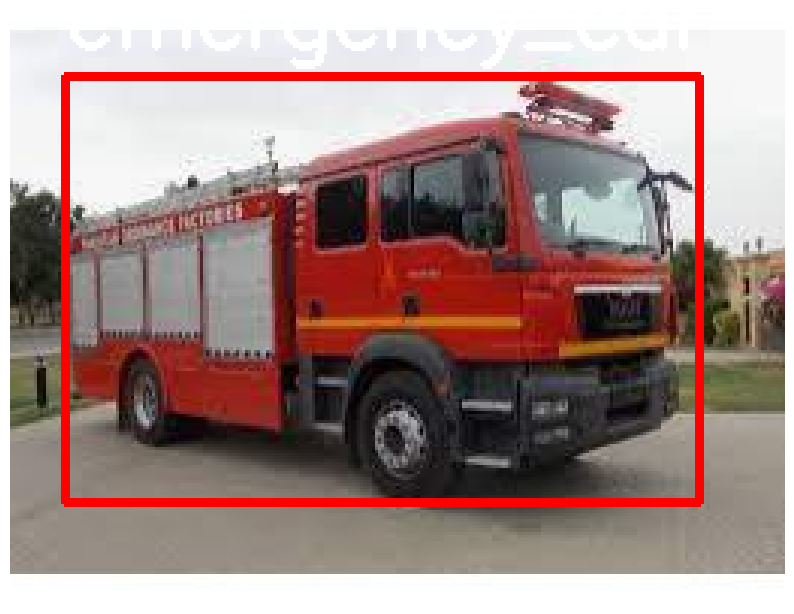

...

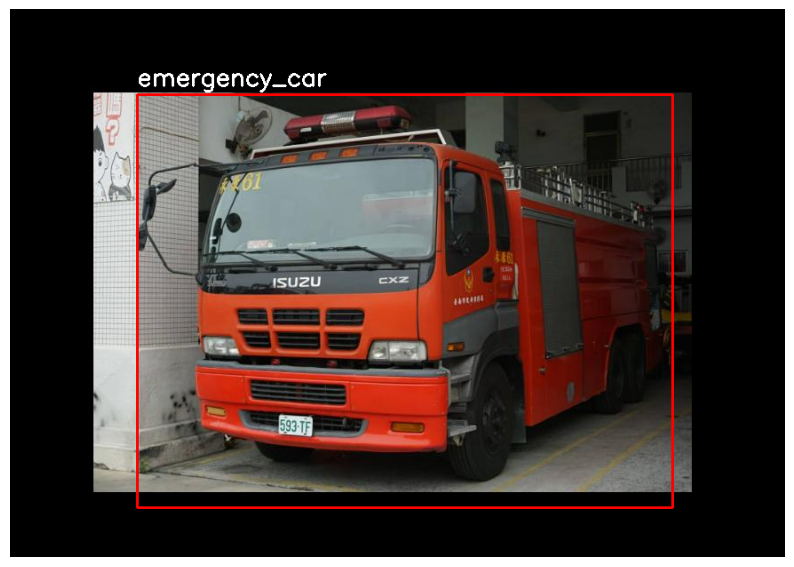

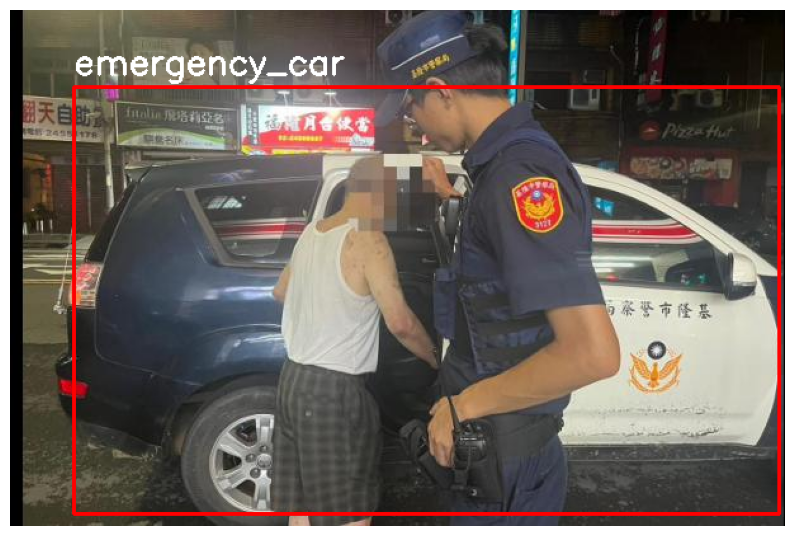

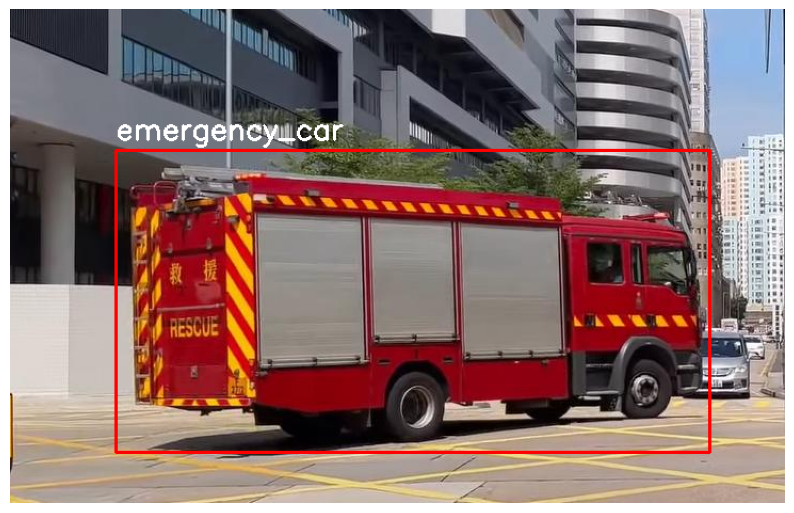

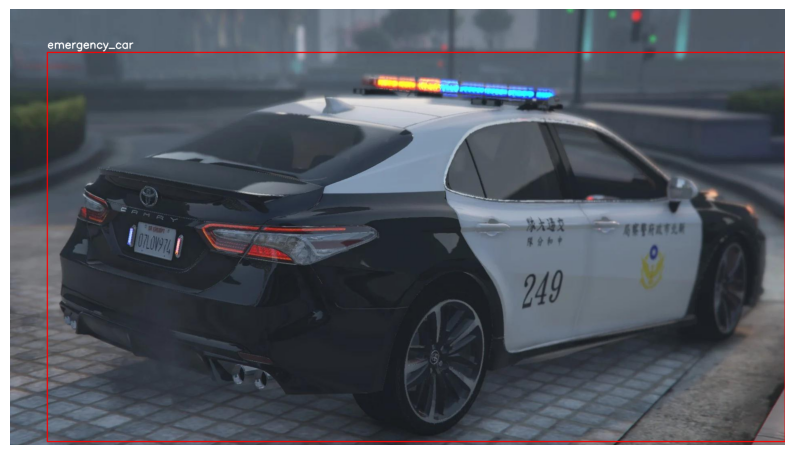

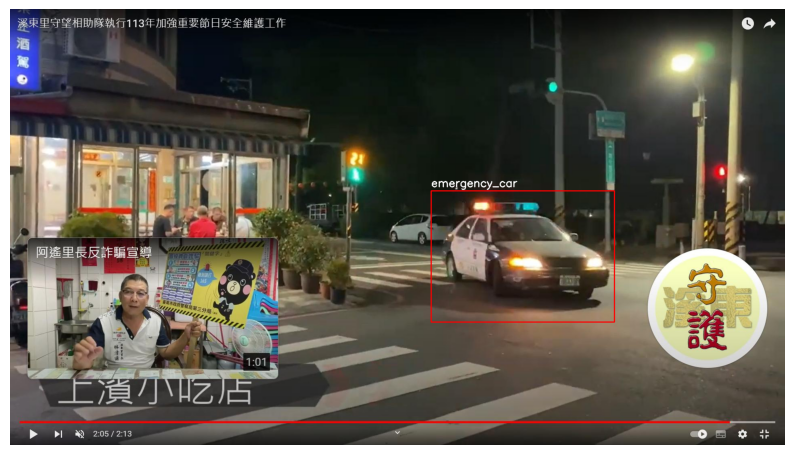

In [ ]:
import os
import random
import matplotlib.pyplot as plt
import cv2

# Class names mapping
class_names = {0: 'emergency_car'}

# Function to display images and their labels
def display_image_with_label(image_path, label_path):
    # Load the image
    image = cv2.imread(image_path)
    if image is None:
        print(f"Image not found: {image_path}")
        return
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Check if label file exists
    if not os.path.exists(label_path):
        print(f"Label file not found: {label_path}")
        return

    # Read the label file
    with open(label_path, 'r') as file:
        labels = file.readlines()

    # Draw bounding boxes on the image
    for label in labels:
        if label.strip() == '':
            continue  # Skip empty lines
        try:
            # Expecting 5 values: class_id, x_center, y_center, width, height
            class_id, x_center, y_center, width, height = map(float, label.strip().split())
            class_id = int(class_id)

            # Convert from YOLO format to pixel format
            img_height, img_width, _ = image.shape
            x_center *= img_width
            y_center *= img_height
            width *= img_width
            height *= img_height

            # Calculate the top-left and bottom-right coordinates
            top_left = (int(x_center - width / 2), int(y_center - height / 2))
            bottom_right = (int(x_center + width / 2), int(y_center + height / 2))

            # Draw the bounding box
            cv2.rectangle(image_rgb, top_left, bottom_right, (255, 0, 0), 2)

            # Display the class name
            cv2.putText(
                image_rgb,
                class_names.get(class_id, str(class_id)),
                (top_left[0], top_left[1] - 10),
                cv2.FONT_HERSHEY_SIMPLEX,
                0.9,
                (255, 255, 255),
                2
            )
        except ValueError as e:
            print(f"Error parsing label in {label_path}: {label.strip()} - {e}")

    # Display the image with bounding boxes
    plt.figure(figsize=(10, 8))
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()

# Specify the paths to the training images and labels
train_images_dir = "combined_dataset/train/images"
train_labels_dir = "combined_dataset/train/labels"

# Get a list of all image files
image_files = [
    f for f in os.listdir(train_images_dir)
    if os.path.isfile(os.path.join(train_images_dir, f))
]

# Randomly select up to 40 images (or fewer if not enough images)
sample_size = min(40, len(image_files))
sample_images = random.sample(image_files, sample_size)

# Display each image and its corresponding label
for image_file in sample_images:
    image_path = os.path.join(train_images_dir, image_file)
    label_file_name = os.path.splitext(image_file)[0] + '.txt'
    label_path = os.path.join(train_labels_dir, label_file_name)

    display_image_with_label(image_path, label_path)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# List the files in your MyDrive folder to verify if the zip file is present
!ls /content/drive/MyDrive/


KeyboardInterrupt: 

In [ ]:
# Download the zip file from Google Drive
!cp /content/drive/MyDrive/Combined-Dataset.zip /content/


In [ ]:
# Unzip the file in the current directory
import zipfile

with zipfile.ZipFile("Combined-Dataset.zip", 'r') as zip_ref:
    zip_ref.extractall("/content/Combined-Dataset")

print("Dataset unzipped successfully.")


In [ ]:
!ls /content/combined_dataset

In [ ]:
!ls /content/Combined-Dataset

In [ ]:
!ls /content/Final-Combined-Dataset

In [ ]:
import os
import shutil
import yaml

# Define paths for Dataset 1 (Combined-Dataset) and Dataset 2 (combined_dataset)
dataset1_dir = "Combined-Dataset"
dataset2_dir = "combined_dataset"

# Output combined dataset directory
combined_dir = "Final-Combined-Dataset2"
os.makedirs(combined_dir, exist_ok=True)

# Function to update class indices and copy files
def update_class_and_copy(src_dir, dest_dir, class_mappings):
    # Get paths to images and labels
    label_dir = os.path.join(src_dir, "train", "labels")
    image_dir = os.path.join(src_dir, "train", "images")

    # Check if label and image directories exist
    if not os.path.exists(label_dir) or not os.path.exists(image_dir):
        print(f"Label or image directory not found in {src_dir}")
        return

    print(f"Processing {src_dir}...")
    print(f"Label directory: {label_dir}")
    print(f"Image directory: {image_dir}")

    # Create destination label and image directories if they don't exist
    os.makedirs(os.path.join(dest_dir, "train", "labels"), exist_ok=True)
    os.makedirs(os.path.join(dest_dir, "train", "images"), exist_ok=True)

    for label_file in os.listdir(label_dir):
        label_path = os.path.join(label_dir, label_file)
        image_path = os.path.join(image_dir, label_file.replace(".txt", ".jpg"))  # Assuming images are jpg

        # Check if the image file exists
        if not os.path.exists(image_path):
            print(f"Image not found: {image_path}")
            continue

        # Read and update the class index in the label file
        with open(label_path, "r") as f:
            lines = f.readlines()

        updated_lines = []
        for line in lines:
            parts = line.strip().split()
            class_index = int(parts[0])  # First value is the class index

            # Update the class index based on the mapping provided
            if class_index in class_mappings:
                new_class_index = class_mappings[class_index]
                updated_lines.append(f"{new_class_index} " + " ".join(parts[1:]))

        # Write updated labels to the destination directory
        dest_label_path = os.path.join(dest_dir, "train", "labels", label_file)
        with open(dest_label_path, "w") as f:
            f.write("\n".join(updated_lines))

        # Copy corresponding image to the destination directory
        dest_image_path = os.path.join(dest_dir, "train", "images", os.path.basename(image_path))
        shutil.copy(image_path, dest_image_path)

# Apply the function to Dataset 1 (Combined-Dataset) and map siren_off (class 0), siren_on (class 1), emergency_car (class 2)
dataset1_mappings = {0: 0, 1: 1, 2: 2}  # Siren_off -> 0, Siren_on -> 1, Emergency_car -> 2
update_class_and_copy(dataset1_dir, combined_dir, dataset1_mappings)

# Apply the function to Dataset 2 (combined_dataset) and map emergency_car (class 0) to class 2
dataset2_mappings = {0: 2}  # emergency_car -> 2
update_class_and_copy(dataset2_dir, combined_dir, dataset2_mappings)

# Function to copy validation and test data from Dataset 2 to Dataset 1
def copy_data(src_dir, dest_dir, data_type):
    for folder in ['images', 'labels']:
        src_folder = os.path.join(src_dir, data_type, folder)
        dest_folder = os.path.join(dest_dir, data_type, folder)
        os.makedirs(dest_folder, exist_ok=True)

        for file_name in os.listdir(src_folder):
            src_file = os.path.join(src_folder, file_name)
            dest_file = os.path.join(dest_folder, file_name)
            shutil.copy(src_file, dest_file)

# Copy validation and test data from combined_dataset to Combined-Dataset
for data_type in ['valid', 'test']:
    copy_data(dataset2_dir, combined_dir, data_type)

# Update the YAML configuration file for the combined dataset
yaml_config = {
    "train": os.path.join(combined_dir, "train", "images"),
    "val": os.path.join(combined_dir, "valid", "images"),
    "test": os.path.join(combined_dir, "test", "images"),
    "nc": 3,  # Number of classes
    "names": ["siren_off", "siren_on", "emergency_car"]
}

# Save the yaml file
yaml_path = os.path.join(combined_dir, "data.yaml")
with open(yaml_path, "w") as yaml_file:
    yaml.dump(yaml_config, yaml_file)

print("Datasets combined and labels updated successfully.")


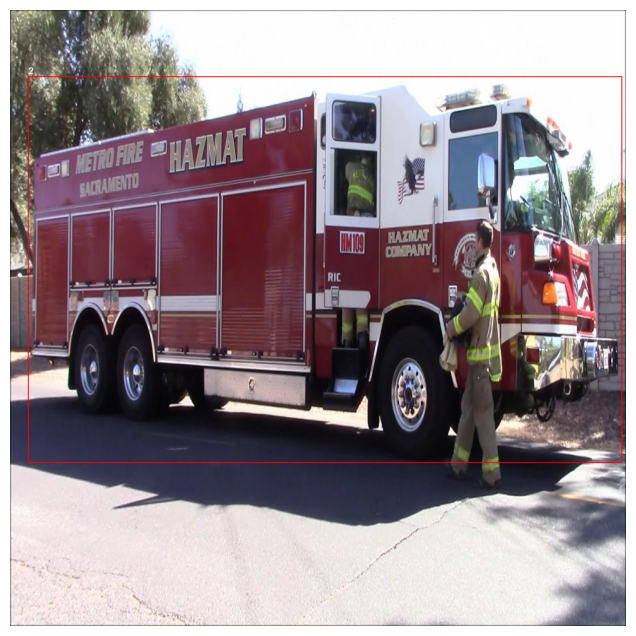

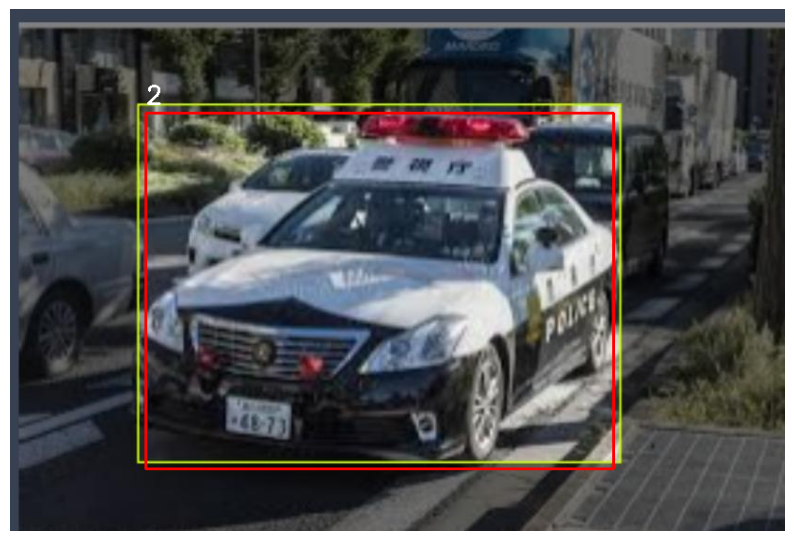

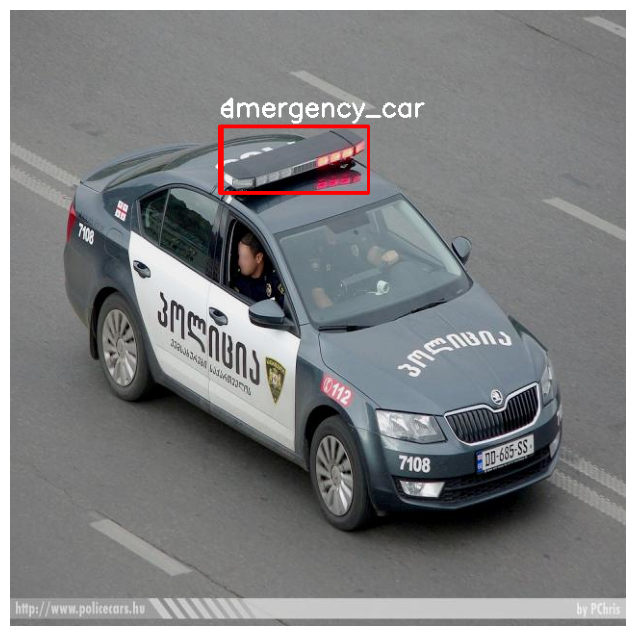

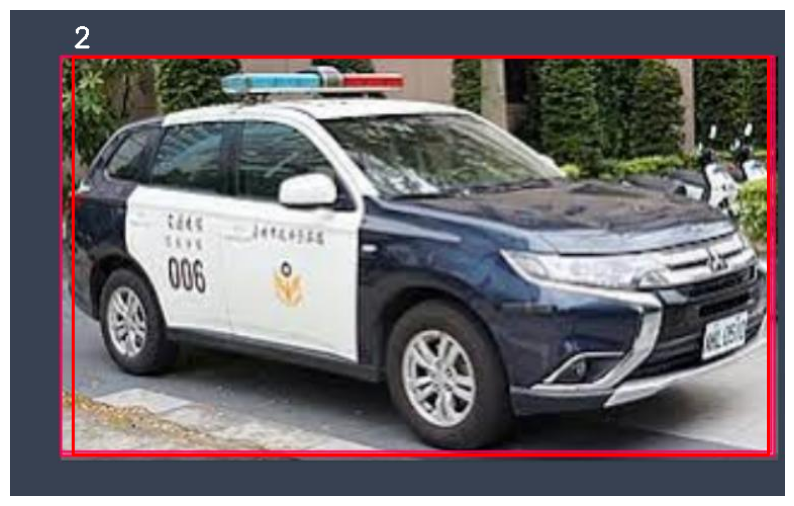

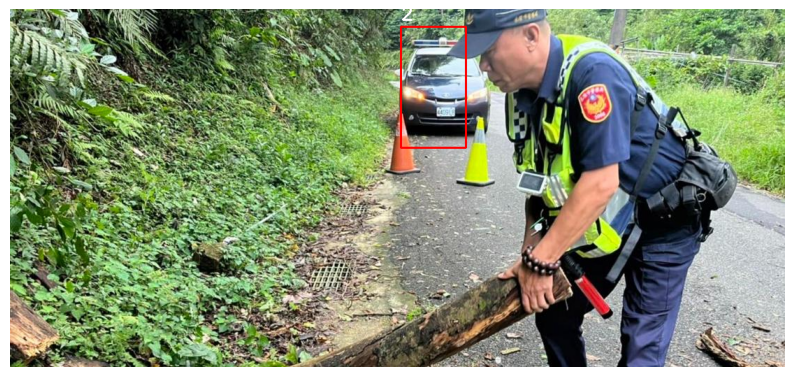

...

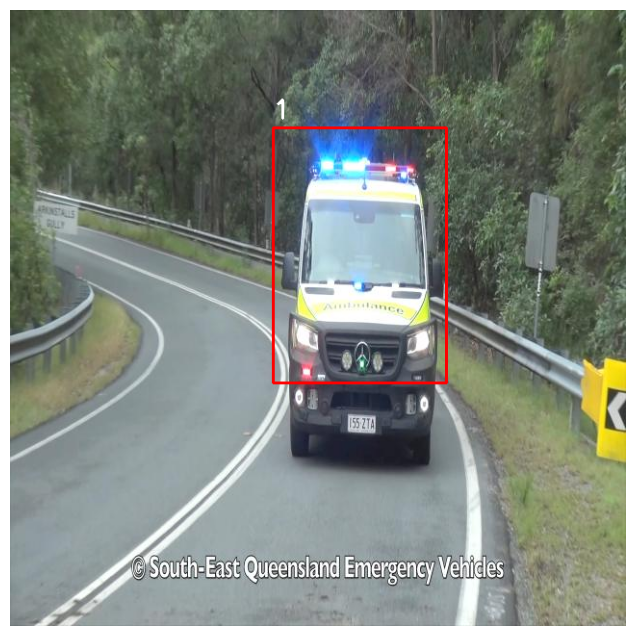

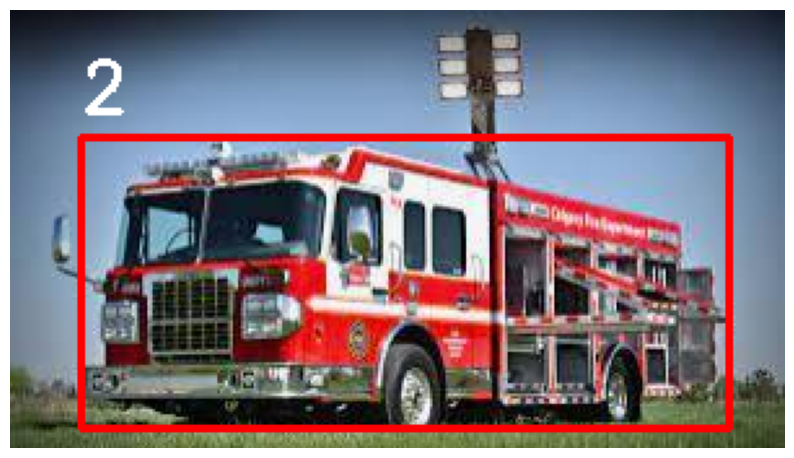

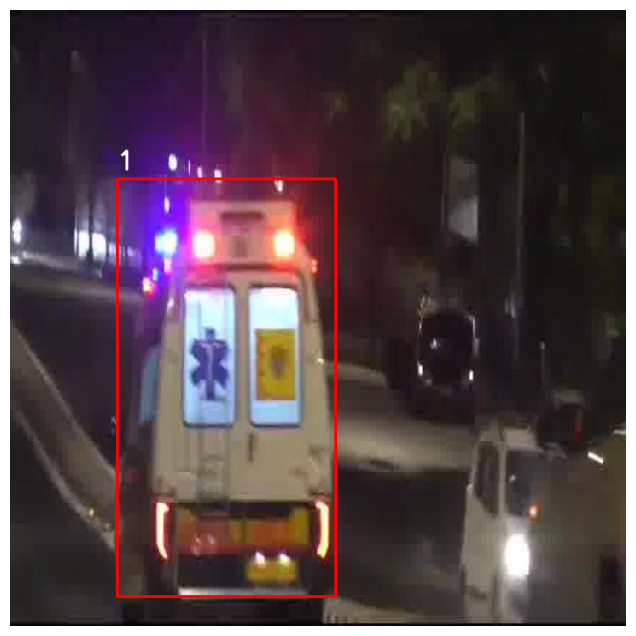

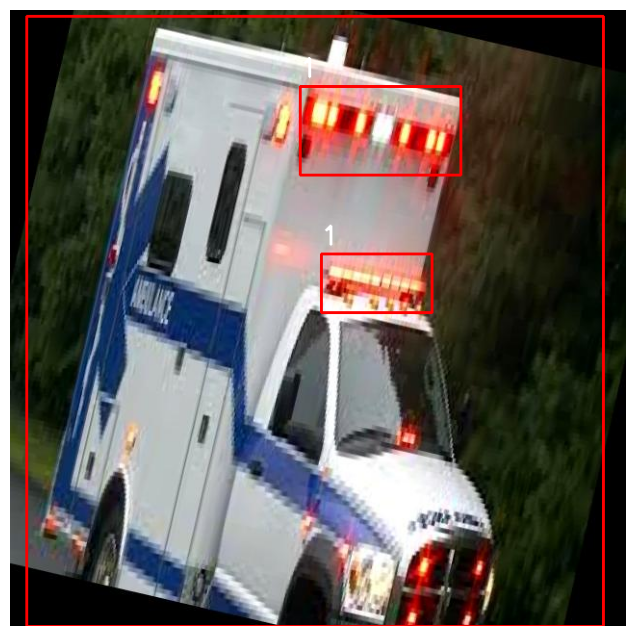

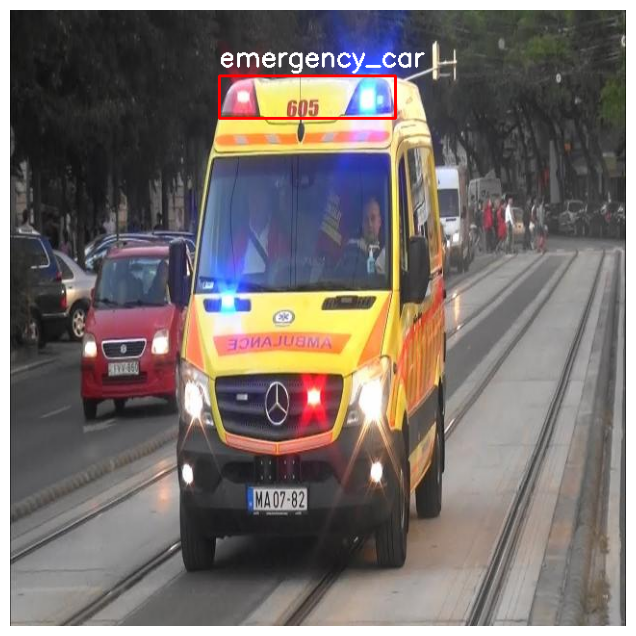

KeyboardInterrupt: 

In [ ]:
import os
import random
import matplotlib.pyplot as plt
import cv2

# Class names mapping
class_names = {0: 'emergency_car'}

# Function to display images and their labels
def display_image_with_label(image_path, label_path):
    # Load the image
    image = cv2.imread(image_path)
    if image is None:
        print(f"Image not found: {image_path}")
        return
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Check if label file exists
    if not os.path.exists(label_path):
        print(f"Label file not found: {label_path}")
        return

    # Read the label file
    with open(label_path, 'r') as file:
        labels = file.readlines()

    # Draw bounding boxes on the image
    for label in labels:
        if label.strip() == '':
            continue  # Skip empty lines
        try:
            # Expecting 5 values: class_id, x_center, y_center, width, height
            class_id, x_center, y_center, width, height = map(float, label.strip().split())
            class_id = int(class_id)

            # Convert from YOLO format to pixel format
            img_height, img_width, _ = image.shape
            x_center *= img_width
            y_center *= img_height
            width *= img_width
            height *= img_height

            # Calculate the top-left and bottom-right coordinates
            top_left = (int(x_center - width / 2), int(y_center - height / 2))
            bottom_right = (int(x_center + width / 2), int(y_center + height / 2))

            # Draw the bounding box
            cv2.rectangle(image_rgb, top_left, bottom_right, (255, 0, 0), 2)

            # Display the class name
            cv2.putText(
                image_rgb,
                class_names.get(class_id, str(class_id)),
                (top_left[0], top_left[1] - 10),
                cv2.FONT_HERSHEY_SIMPLEX,
                0.9,
                (255, 255, 255),
                2
            )
        except ValueError as e:
            print(f"Error parsing label in {label_path}: {label.strip()} - {e}")

    # Display the image with bounding boxes
    plt.figure(figsize=(10, 8))
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()

# Specify the paths to the training images and labels
train_images_dir = "Final-Combined-Dataset/train/images"
train_labels_dir = "Final-Combined-Dataset/train/labels"

# Get a list of all image files
image_files = [
    f for f in os.listdir(train_images_dir)
    if os.path.isfile(os.path.join(train_images_dir, f))
]

# Randomly select up to 40 images (or fewer if not enough images)
sample_size = min(80, len(image_files))
sample_images = random.sample(image_files, sample_size)

# Display each image and its corresponding label
for image_file in sample_images:
    image_path = os.path.join(train_images_dir, image_file)
    label_file_name = os.path.splitext(image_file)[0] + '.txt'
    label_path = os.path.join(train_labels_dir, label_file_name)

    display_image_with_label(image_path, label_path)


In [ ]:
import shutil

folder_to_zip = "Final-Combined-Dataset"
zip_filename = "Final-Combined-Dataset.zip"

shutil.make_archive(zip_filename.replace(".zip", ""), 'zip', folder_to_zip)

print(f"Zipped {folder_to_zip} into {zip_filename}.")


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

drive_path = "/content/drive/MyDrive/Final-Combined-Dataset.zip"

shutil.move(zip_filename, drive_path)

print(f"Uploaded {zip_filename} to Google Drive at {drive_path}.")


In [ ]:
from collections import Counter

def count_class_instances(labels_dir):
    class_counts = Counter()
    for label_file in os.listdir(labels_dir):
        label_path = os.path.join(labels_dir, label_file)
        with open(label_path, 'r') as f:
            lines = f.readlines()
            for line in lines:
                class_id = int(line.strip().split()[0])
                class_counts[class_id] += 1
    return class_counts

In [ ]:
combined_labels_dir = 'Final-Combined-Dataset2/train/labels'
class_counts = count_class_instances(combined_labels_dir)

In [ ]:
class_names = ['siren_off', 'siren_on', 'emergency_car']

print("Class Distribution in Combined Dataset:")
for class_id, count in class_counts.items():
    print(f'Class {class_id} ({class_names[class_id]}): {count} instances')

In [ ]:
combined_labels_dir = 'Combined-Dataset/train/labels'
class_counts = count_class_instances(combined_labels_dir)
class_names = ['siren_off', 'siren_on', 'emergency_car']


In [ ]:

print("Class Distribution in Combined Dataset:")
for class_id, count in class_counts.items():
    print(f'Class {class_id} ({class_names[class_id]}): {count} instances')

In [ ]:
combined_labels_dir = 'combined_dataset/train/labels'
class_counts = count_class_instances(combined_labels_dir)
class_names = ['emergency_car']


In [ ]:

print("Class Distribution in Combined Dataset:")
for class_id, count in class_counts.items():
    print(f'Class {class_id} ({class_names[class_id]}): {count} instances')